In [1]:
import pandas as pd
from google.cloud import bigquery
import ydata_profiling as pp
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib as mpl

# set the maximum number of columns to be displayed
pd.set_option('display.max_columns', None)

In [2]:
!gcloud auth application-default login

Your browser has been opened to visit:

    https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=764086051850-6qr4p6gpi6hn506pt8ejuq83di341hur.apps.googleusercontent.com&redirect_uri=http%3A%2F%2Flocalhost%3A8085%2F&scope=openid+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fcloud-platform+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fsqlservice.login+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Faccounts.reauth&state=iC2kyljinOcCzF1gs0nGctPG7DiWbe&access_type=offline&code_challenge=CSNn6hGdC6MffbcCSD5_l9mYwVg5YHWlCJD3XXR7Sks&code_challenge_method=S256


Credentials saved to file: [C:\Users\iankk\AppData\Roaming\gcloud\application_default_credentials.json]

These credentials will be used by any library that requests Application Default Credentials (ADC).

Quota project "egd-project" was added to ADC which can be used by Google client libraries for billing and quota. Note that some services may still bill the project owning t

In [3]:
pd.set_option('display.max_columns', None)
# Set the float format to display numbers without scientific notation
pd.options.display.float_format = '{:.2f}'.format
# Set the client for future queries to BigQuery
client = bigquery.Client(project = "continente-lced-feup")

In [4]:
query = client.query("""
   SELECT *
     FROM `continente-lced-feup.tables_raw.dim_customer` 
   """)

df_customer = query.result().to_dataframe() # Wait for the job to complete.

query = client.query("""
    SELECT *
    FROM `continente-lced-feup.tables_raw.dim_product`
    """)
df_product = query.result().to_dataframe() # Wait for the job to complete.

query = client.query("""
    SELECT *
    FROM `continente-lced-feup.tables_raw.fact_transaction`
    LIMIT 2000000
    """)
fact_transaction = query.result().to_dataframe() # Wait for the job to complete.

query = client.query("""
    SELECT *
    FROM `continente-lced-feup.tables_raw.dim_location`
    """)
df_location = query.result().to_dataframe() # Wait for the job to complete.

In [5]:
customer = df_customer
product = df_product
location = df_location
transaction = fact_transaction
# Define the colors
colors = ['#FD0505', '#970707']

# Create a list of relative positions for each color
positions = [0, 1]

# Create the custom colormap
cmap = mcolors.LinearSegmentedColormap.from_list("", list(zip(positions, colors)))
try:
    mpl.colormaps.register(mcolors.LinearSegmentedColormap('contRed', cmap))
except ValueError:
    pass

In [6]:
### CReate a Correlation Matrix
corr = transaction.corr()

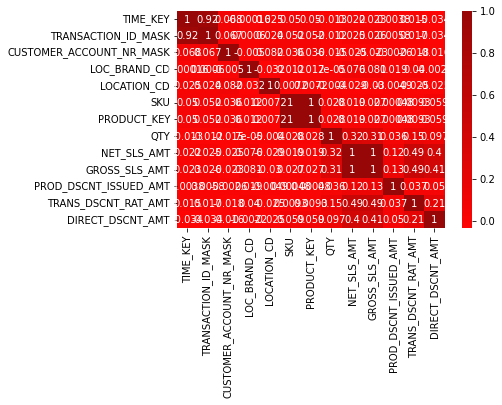

In [10]:
plot = sns.heatmap(corr, cmap=cmap, annot=True)

In [41]:
#Check the data
pp.ProfileReport(customer)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [42]:
pp.ProfileReport(product)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [43]:
pp.ProfileReport(location)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [54]:
pp.ProfileReport(transaction)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
"""customer (CUSTOMER_ACCOUNT_NR_MASK) - sample (CUSTOMER_ACCOUNT_NR_MASK)
product (SKU) - sample (SKU)"""
# merge 3 dfs
df_merge = transaction.merge(location).merge(customer, on='CUSTOMER_ACCOUNT_NR_MASK').merge(product, on='SKU')

In [7]:
df_merge.isnull().sum()

TIME_KEY                      0
TRANSACTION_ID_MASK           0
CUSTOMER_ACCOUNT_NR_MASK      2
LOC_BRAND_CD                  0
LOCATION_CD                   0
POS_TP_CD                     0
SKU                           0
PRODUCT_KEY                   0
QTY                           0
NET_SLS_AMT                   0
GROSS_SLS_AMT                 0
PROD_DSCNT_ISSUED_AMT         0
TRANS_DSCNT_RAT_AMT           0
DIRECT_DSCNT_AMT              0
LOCATION_DSC                  0
LOC_BRAND_DSC                 0
cp7                           0
GENDER                      234
FAMILY_MEMBERS              889
CP4                         267
seg_lifestyle_cd              0
seg_lifestyle_dsc             0
SEG_AGE                       0
SEG_AGE_DSC                   0
seg_lifestage_cd              0
seg_lifestage_dsc             0
PRODUCT_DSC                   0
UNIT_BASE_CD_EXT              0
UNIT_BASE_DSC_EXT             0
SUBCAT_CD_EXT                 0
SUBCAT_DSC_EXT                0
CAT_CD_E

<AxesSubplot:xlabel='PRICE_RANGE', ylabel='Count'>

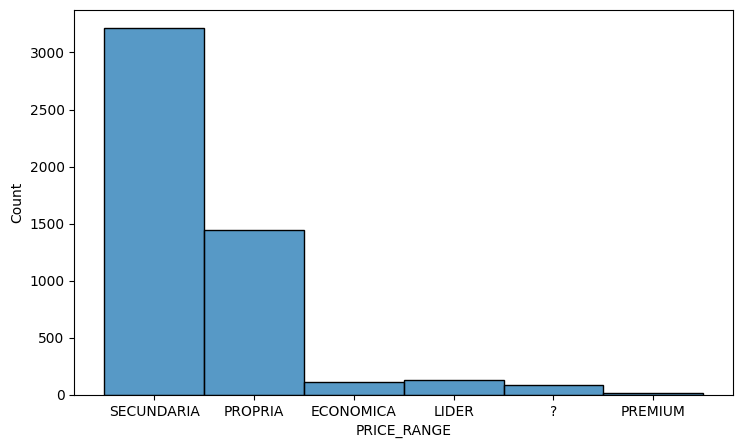

In [8]:
fig, axes = plt.subplots(figsize=(8.5,5), ncols=1, sharey=True)
sns.histplot(data=df_merge.PRICE_RANGE, binwidth=3)

In [9]:
df_merge

,TIME_KEY,TRANSACTION_ID_MASK,CUSTOMER_ACCOUNT_NR_MASK,LOC_BRAND_CD,LOCATION_CD,POS_TP_CD,SKU,PRODUCT_KEY,QTY,NET_SLS_AMT,GROSS_SLS_AMT,PROD_DSCNT_ISSUED_AMT,TRANS_DSCNT_RAT_AMT,DIRECT_DSCNT_AMT,LOCATION_DSC,LOC_BRAND_DSC,cp7,GENDER,FAMILY_MEMBERS,CP4,seg_lifestyle_cd,seg_lifestyle_dsc,SEG_AGE,SEG_AGE_DSC,seg_lifestage_cd,seg_lifestage_dsc,PRODUCT_DSC,UNIT_BASE_CD_EXT,UNIT_BASE_DSC_EXT,SUBCAT_CD_EXT,SUBCAT_DSC_EXT,CAT_CD_EXT,CAT_DSC_EXT,BIZ_UNIT_CD_EXT,BIZ_UNIT_DSC_EXT,DEPARTMENT_CD_EXT,DEPARTMENT_DSC_EXT,PRODUCT_SHORT_DSC,BRAND_DSC,BRAND_TYPE_CD,PRICE_RANGE,CONVERSION_FACTOR,CAPACITY_UNIT
0,20220508,8866258034017223288,83625674.0,303,239,P,7330462,7330462010001,1.0,0.6423,0.79,0.0,0.079010,0,MDL BRAGANCA,continente modelo,5300,F,NaN,5300,1,Qualidade,SA_2,]18;25],5,Active Adults,BLOCO APONT A7 80F 60GR LISO NOTE!,33020224,33020224 - blocos,330202,330202 - cadernos e papel,3302,3302 - papelaria,33,33 - Cultura,23,23 - BAZAR,BLOCO APONT A7,NOTE!,MP,SECUNDARIA,1.00,UN
1,20221102,8756093530610753087,34858968.0,303,239,P,7368462,7368462010001,1.0,1.0163,1.25,0.0,0.000000,0,MDL BRAGANCA,continente modelo,5300,M,3.0,5300,2,Família,SA_5,]45;55],4,Family with Kids,GELATINA CONTINENTE MORANGO 6*100G,8041106,08041106 - Gelatinas Prontas,80411,080411 - sobremesas,804,0804 - iogurtes e sobrem.,8,08 - Laticínios/Beb. Veg.,10,10 - ALIMENTAR,GELATINA MORANG,CONT.POUPANCA,MP,SECUNDARIA,0.60,KG
2,20221111,8765110037131229357,51548719.0,143,4,P,7368462,7368462010001,1.0,1.0163,1.25,0.0,0.318946,0,CNT GAIASHOPPING,continente,4404,M,NaN,4430,2,Família,SA_5,]45;55],5,Active Adults,GELATINA CONTINENTE MORANGO 6*100G,8041106,08041106 - Gelatinas Prontas,80411,080411 - sobremesas,804,0804 - iogurtes e sobrem.,8,08 - Laticínios/Beb. Veg.,10,10 - ALIMENTAR,GELATINA MORANG,CONT.POUPANCA,MP,SECUNDARIA,0.60,KG
3,20220924,8751781569578971342,4817579.0,302,3864,P,7368462,7368462010001,1.0,1.0163,1.25,0.0,0.000000,0,CBD CALDAS TAIPAS,continente bom dia,4805,F,4.0,4805,2,Família,SA_4,]35;45],5,Active Adults,GELATINA CONTINENTE MORANGO 6*100G,8041106,08041106 - Gelatinas Prontas,80411,080411 - sobremesas,804,0804 - iogurtes e sobrem.,8,08 - Laticínios/Beb. Veg.,10,10 - ALIMENTAR,GELATINA MORANG,CONT.POUPANCA,MP,SECUNDARIA,0.60,KG
4,20220912,8740982114387001912,34858968.0,303,239,P,3074985,3074985010001,1.0,0.7236,0.89,0.0,0.000000,0,MDL BRAGANCA,continente modelo,5300,M,3.0,5300,2,Família,SA_5,]45;55],4,Family with Kids,(I)ESPONJA BANHO CONTINENTE 3UN,5030601,05030601 - Outros Acess. Banho,50306,050306 - acessórios banho,503,0503 - higiene corporal,5,05 - Higiene,10,10 - ALIMENTAR,ESPONJA 3UN,CONTINENTE,MP,PROPRIA,3.00,UN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4994,20221230,9137231893782675554,50374079.0,302,4289,P,6574808,6574808010001,1.0,1.3740,1.69,0.0,0.804785,0,CBD V REAL S ANTONIO,continente bom dia,8900,F,NaN,2625,1,Qualidade,SA_4,]35;45],3,Family w/ Young Adul,SALSICHAS CHURRASCO CONTINENTE 200G,13020702,13020702 - salsichas corr ls,130207,130207 - enchidos corr (ls),1302,1302 - Charcutaria,13,13 - Charcutaria&Queijos,12,12 - F&L C&Q PAD TAWAY,SALSICHAS CHURR,CONTINENTE,MP,SECUNDARIA,0.20,KG
4995,20220912,8740982016873536173,75834880.0,302,4289,P,2907937,2907937010001,2.0,1.3982,1.58,0.0,0.000000,0,CBD V REAL S ANTONIO,continente bom dia,8900,M,0.0,8950,1,Qualidade,SA_7,>65,2,Senior,EMPADAS GALINHA CG 80G,18010204,18010204 - empadas e empanadas,180102,180102 - Salgados,1801,1801 - TA Atendimento,18,18 - Take Away,12,12 - F&L C&Q PAD TAWAY,EMPADAS GALINHA,CONTINENTE AT,MP,SECUNDARIA,0.08,KG
4996,20221025,8784113368697550763,57063551.0,302,3609,P,6838203,6838203010001,1.0,1.5000,1.59,0.0,0.000000,0,CBD AVANCA,continente bom dia,3860,M,NaN,0000,2,Família,SA_7,>65,2,Senior,IOG LIQ CONTINENTE MORANGO 1KG,8040404,08040404 - Liq. Familiares,80404,080404 - líquidos,804,0804 - iogurtes e sobrem.,8,08 - Laticínios/Beb. Veg.,10,